# Preparing library that will be used in all code

In [1]:
!pip install text-hammer

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.1/115.1 KB 3.5 MB/s eta 0:00:00
  Attempting uninstall: beautifulsoup4
    Found existing installation: beautifulsoup4 4.11.2
    Uninstalling beautifulsoup4-4.11.2:
      Successfully uninstalled beautifulsoup4-4.11.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yfinance 0.2.14 requires beautifulsoup4>=4.11.1, but you have beautifulsoup4 4.9.1 which is incompatible.


In [2]:
pip install stop-words

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for stop-words: filename=stop_words-2018.7.23-py3-none-any.whl size=32910 sha256=f6353eb27ac0088e947df77b918db3374f9ad2a9740047b86995c66ef49225a1
  Stored in directory: /root/.cache/pip/wheels/da/d8/66/395317506a23a9d1d7de433ad6a7d9e6e16aab48cf028a0f60
Successfully built stop-words


In [3]:
!pip3 install scikit-learn-extra

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 23.7 MB/s eta 0:00:00


### Import library

In [4]:
import pandas as pd
import numpy as np
import text_hammer as th
import re
import random

import spacy

import nltk
nltk.download('punkt')

from nltk import FreqDist

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
# Parameters tuning using Grid Search
from sklearn.model_selection import GridSearchCV

import matplotlib.pyplot as plt
from wordcloud import WordCloud

from PIL import Image
from stop_words import get_stop_words
stopwords = get_stop_words('english')

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from nltk import ngrams

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


# Preparing document (raw dataset) that was already scraped from taiwannews.com.tw. This step can be ignored if filtered dataset is provided

In [5]:
# in this code I upload all scraping result file.
# each file contain 1000 news data before it is filtered into filtered-news file
from google.colab import files
uploaded = files.upload()

Saving 4838699-4839698.csv to 4838699-4839698.csv
Saving 4839699-4840698.csv to 4839699-4840698.csv
Saving 4840699-4841698.csv to 4840699-4841698.csv
Saving 4841699-4842698.csv to 4841699-4842698.csv
Saving 4842699-4843698.csv to 4842699-4843698.csv
Saving 4843699-4844698.csv to 4843699-4844698.csv
Saving 4844699-4845698.csv to 4844699-4845698.csv
Saving 4845699-4846698.csv to 4845699-4846698.csv
Saving 4846699-4847698.csv to 4846699-4847698.csv
Saving 4847699-4848698.csv to 4847699-4848698.csv
Saving 4848699-4849698.csv to 4848699-4849698.csv
Saving 4849699-4850698.csv to 4849699-4850698.csv
Saving 4850699-4851698.csv to 4850699-4851698.csv
Saving 4851699-4852698.csv to 4851699-4852698.csv
Saving 4852699-4853698.csv to 4852699-4853698.csv
Saving 4796099-4796198.csv to 4796099-4796198.csv
Saving 4796199-4796298.csv to 4796199-4796298.csv
Saving 4796299-4796398.csv to 4796299-4796398.csv
Saving 4796399-4796498.csv to 4796399-4796498.csv
Saving 4796499-4796598.csv to 4796499-4796598.csv


In [6]:
# read all rows in all files
# and give the appropriate column name to make it easier to be processed
df = pd.DataFrame()
for fileName in uploaded.keys():
  dfLoad = pd.read_csv(fileName, header=None, skiprows=1)
  df = pd.concat([df, dfLoad], ignore_index=True, axis=0)

df.set_axis(['Url', 'Title', 'Text', 'Date', 'Views', 'Label'], axis='columns', inplace=True)

In [7]:
# check the news data
df

,Url,Title,Text,Date,Views,Label
0,https://www.taiwannews.com.tw/en/news/4838699,NaN,NaN,NaN,NaN,NaN
1,https://www.taiwannews.com.tw/en/news/4838700,NaN,NaN,NaN,NaN,NaN
2,https://www.taiwannews.com.tw/en/news/4838701,NaN,NaN,NaN,NaN,NaN
3,https://www.taiwannews.com.tw/en/news/4838702,NaN,NaN,NaN,NaN,NaN
4,https://www.taiwannews.com.tw/en/news/4838703,Canadian intel agency confirms Chinese interfe...,TAIPEI (Taiwan News) — A report from the Canad...,2023/3/17,1200.0,World
...,...,...,...,...,...,...
57573,https://www.taiwannews.com.tw/en/news/4838694,"White Beer Market In-Depth Analysis, Size, Sha...",Global Overview of the White Beer MarketThe Wh...,2023/3/17,NaN,NaN
57574,https://www.taiwannews.com.tw/en/news/4838695,Taiwan will host 2024 World Indigenous Travel ...,TAIPEI (Taiwan News) — Taiwan has been chosen ...,2023/3/17,373.0,Travel & Cuisine
57575,https://www.taiwannews.com.tw/en/news/4838696,Paraguay reaffirms its ties of friendship and ...,Paraguay reaffirms its ties of friendship and ...,2023/3/17,684.0,Opinion
57576,https://www.taiwannews.com.tw/en/news/4838697,NaN,NaN,NaN,NaN,NaN


In [8]:
# remove duplicate data in dataset 
# and remove data without label (NAN value)
df = df.drop_duplicates(keep="first")
df = df.dropna(subset = ['Label'])

In [9]:
# check dataset after removing duplicate and remove all rows with NAN value in label
df

,Url,Title,Text,Date,Views,Label
4,https://www.taiwannews.com.tw/en/news/4838703,Canadian intel agency confirms Chinese interfe...,TAIPEI (Taiwan News) — A report from the Canad...,2023/3/17,1200.0,World
9,https://www.taiwannews.com.tw/en/news/4838708,Former Australian PM Paul Keating labels Taiwa...,TAIPEI (Taiwan News) — During a tirade over ne...,2023/3/17,2137.0,Politics
10,https://www.taiwannews.com.tw/en/news/4838709,Taiwan needs FinTech and trade-based money lau...,TAIPEI (Taiwan News) — Taiwan's banks have ove...,2023/3/18,969.0,Opinion
34,https://www.taiwannews.com.tw/en/news/4838733,Taiwan finds H9N2 bird flu on outlying island ...,TAIPEI (Taiwan News) — Taiwan ordered the clos...,2023/3/17,1950.0,Food Safety & Health
88,https://www.taiwannews.com.tw/en/news/4838787,SDC Championship Par Scores,Thursday\n At St. Francis Links...,2023/3/17,NaN,World
...,...,...,...,...,...,...
57548,https://www.taiwannews.com.tw/en/news/4838669,Mozambicans march to honor protest rapper afte...,"MAPUTO, Mozambique (AP) — Mozambicans are plan...",2023/3/17,NaN,World
57549,https://www.taiwannews.com.tw/en/news/4838670,Pakistan athlete who died in migrant boat cras...,"QUETTA, Pakistan (AP) — Mourners attended the ...",2023/3/17,NaN,World
57551,https://www.taiwannews.com.tw/en/news/4838672,Patrick Vieira fired by relegation-threatened ...,LONDON (AP) — Patrick Vieira was fired by Crys...,2023/3/17,NaN,World
57574,https://www.taiwannews.com.tw/en/news/4838695,Taiwan will host 2024 World Indigenous Travel ...,TAIPEI (Taiwan News) — Taiwan has been chosen ...,2023/3/17,373.0,Travel & Cuisine


In [10]:
# check number of news based on label value
df.value_counts('Label')

Label
World                     12808
Politics                    438
Society                     261
Business                    128
Travel & Cuisine             94
Environment                  80
Food Safety & Health         77
Sports & Entertainment       58
Culture                      41
Opinion                      41
Photo of the Day             11
New Immigrants                4
SPONSORED                     4
dtype: int64

In [12]:
# decrease the number of news that are used in clustering for decreasing processing time
# filter the dataset and retrieve the dataset labeled politics, society and business
# save to file
newdf = df[(df['Label']=='Politics') | (df['Label']=='Society') | (df['Label']=='Business')]
newdf.to_csv("politic_society_business.csv", index=False)

# Upload news dataset that is already filtered

In [39]:
# this code is used for uploading the filtered version of news dataset
# read and store in dataframe
from google.colab import files
uploaded = files.upload()
file_name = list(uploaded.keys())[0]
newdf = pd.read_csv(file_name, sep=",", header=0)

Saving politic_society_business.csv to politic_society_business (1).csv


In [40]:
# upload image_mask that will be used in wordcloud
from google.colab import files
uploadedImage = files.upload()
mask_image = list(uploadedImage.keys())[0]
mask_image

Saving cloud.png to cloud (1).png


'cloud.png'

In [41]:
# check dataframe
newdf

,Url,Title,Text,Date,Views,Label
0,https://www.taiwannews.com.tw/en/news/4796805,Taiwan Legislative Speaker You Si-kun arrives ...,"TAIPEI (Taiwan News) — After a 14-hour flight,...",2023/2/1,688.0,Politics
1,https://www.taiwannews.com.tw/en/news/4797037,Taiwan tops Asia in 2022 Human Freedom Index,TAIPEI (Taiwan News) — Taiwan emerged as the f...,2023/2/1,1081.0,Society
2,https://www.taiwannews.com.tw/en/news/4797083,Duck hunt comes to conclusion in southern Taiwan,TAIPEI (Taiwan News) — One would be tempted to...,2023/2/1,2304.0,Society
3,https://www.taiwannews.com.tw/en/news/4797107,Taiwan business leader joins DPP-linked think ...,TAIPEI (Taiwan News) — The chairman of Pegatro...,2023/2/1,622.0,Politics
4,https://www.taiwannews.com.tw/en/news/4797204,DPP Chairman Lai names 3 key tasks for Taiwan’...,TAIPEI (Taiwan News) — In his first address to...,2023/2/1,879.0,Politics
...,...,...,...,...,...,...
822,https://www.taiwannews.com.tw/en/news/4841075,"If China attacks Taiwan, war could start in sp...",TAIPEI (Taiwan News) — In a new CBS broadcast ...,2023/3/20,8922.0,Politics
823,https://www.taiwannews.com.tw/en/news/4841082,"Taiwan, Japan ruling parties to discuss securi...",TAIPEI (Taiwan News) — Taiwan’s Democratic Pro...,2023/3/20,1134.0,Politics
824,https://www.taiwannews.com.tw/en/news/4841167,"Taiwan TikToker rushes court at Dwight Howard,...",TAIPEI (Taiwan News) — A Taiwanese TikToker ru...,2023/3/20,2857.0,Society
825,https://www.taiwannews.com.tw/en/news/4841191,Putin to host ally Xi in Russia as Ukraine war...,Russian President Vladimir Putin hosts Chinese...,2023/3/20,334.0,Politics


In [42]:
# check for label distribution
# if using other dataset, you need to change it
newdf.value_counts('Label')
# newdf.value_counts('Genre')

# define column name in dataset that will be processed
column_name = "Text"
# column_name = "Synopsis"

# Preparing code for cleaning, vectorizer, clustering, word visualization

### class (code) for cleaning

In [43]:
# create cleaning class which has several function
# spacy_preprocess is remove stopword, lemmatization, and feature selection using pos tag
# remove_stopword is remove stopword
# cleaning_process is function that is used for cleaning dataset
# in cleaning process, text hammer library is employed to get a clean dataset
class cleaning():
  def __init__(self):
    self.nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner']) # disable parser, ner for faster loading
  
  # Define function for Lemmatization, remove stopword and feature selection using POS, spacy package
  def spacy_preprocess (self, text, lemma= True, pos= True, pos_select = ["VERB", "NOUN", "ADJ", "ADV", "PART"]):
    # Initialize spacy 'en_core_web_sm' model, keeping only tagger component needed for lemmatization
    # Parse the sentence using the loaded 'en' model object `nlp`
    doc = self.nlp(text)

    if pos== False:
      if lemma== True: text_preprocess= " ".join([token.lemma_.lower() for token in doc if not self.nlp.vocab[token.text].is_stop])
      if lemma== False: text_preprocess= " ".join([token.text.lower() for token in doc if not self.nlp.vocab[token.text].is_stop])
    else:
      if lemma== True : text_preprocess= " ".join([token.lemma_.lower() for token in doc if (token.pos_ in pos_select and not self.nlp.vocab[token.text].is_stop)])
      if lemma== False : text_preprocess= " ".join([token.text.lower() for token in doc if (token.pos_ in pos_select  and not self.nlp.vocab[token.text].is_stop)])
    # nlp.vocab[token.text].is_stop to remove stopwords
    return text_preprocess
  
  def remove_stopword(self, text):
    wordList = []
    tempText = nltk.word_tokenize(text)
    for word in tempText:
      if word not in stopwords:
        wordList.append(word)
    text = (" ".join(wordList))
    return text

  def cleaning_process(self, dataframe, column):
    dataframe[column] = dataframe[column].progress_apply(lambda x: th.cont_exp(str(x))) #you're -> you are; i'm -> i am
    dataframe[column] = dataframe[column].progress_apply(lambda x: th.remove_emails(str(x)))
    dataframe[column] = dataframe[column].progress_apply(lambda x: th.remove_html_tags(str(x)))

    dataframe[column] = dataframe[column].progress_apply(lambda x: th.remove_special_chars(str(x)))
    dataframe[column] = dataframe[column].progress_apply(lambda x: th.remove_accented_chars(str(x)))

    dataframe[column] = dataframe[column].progress_apply(lambda x: re.sub(r'[^\w|^\']',' ',str(x)))
    dataframe[column] = dataframe[column].progress_apply(lambda x: re.sub("\d+", "",str(x)))

    # i ignore these 2 lines, since it takes time to process
    # dataframe[column] = dataframe[column].progress_apply(lambda x: th.make_base(x)) #ran -> run, 
    # dataframe[column] = dataframe[column].progress_apply(lambda x: th.spelling_correction(x).raw_sentences[0]) #seplling -> spelling
    dataframe[column] = dataframe[column].progress_apply(lambda x: self.spacy_preprocess(str(x), pos_select = ["VERB", "NOUN", "ADJ"]))
    dataframe[column] = dataframe[column].progress_apply(lambda x: self.remove_stopword(str(x)))
    return dataframe

### class (code) for vectorizer

In [44]:
# create class vectorizer to process tfidf vectorizer
# has several function to get get_feature_names_out and document_term_matrix

class vectorizer():
  def __init__(self, dataframe, column):
    self.vectorizer = TfidfVectorizer(stop_words='english', min_df=0.1, max_df=0.8, max_features= None)
    self.document_term_matrix = self.vectorizer.fit_transform(dataframe[column].tolist()).astype(float)
    # print ("document matrix shape :", self.document_term_matrix.shape)

  def get_vocab(self):
    return self.vectorizer.get_feature_names_out()

  def get_term_matrix(self):
    return self.document_term_matrix


### class (code) for k-means clustering

In [45]:
class kmeans_clustering():
  def k_means(self, num_clusters, feature_matrix):
    km = KMeans(n_clusters=num_clusters, n_init=500, random_state = 1,
                max_iter=10000)
    km.fit(feature_matrix)
    self.clusters = km.labels_
    return km, self.clusters, num_clusters

  def assign_cluster(self, dataframe):
    dataframe['cluster'] = self.clusters
    return dataframe

### class (code) for k-medoid clustering

In [46]:
class kmedoid_clustering():
  def k_medoids(self, num_clusters, feature_matrix):
    kmedoids = KMedoids(n_clusters=num_clusters, init='k-medoids++', random_state=1,
              max_iter=10000)
    kmedoids.fit(feature_matrix)
    self.clusters = kmedoids.labels_
    return kmedoids, self.clusters, num_clusters

  def assign_cluster(self, dataframe):
    dataframe['cluster'] = self.clusters
    return dataframe

### class (code) for lda clustering

In [47]:
# create class lda clustering
# auto_fit_transform using gridsearch cross validation to get the best lda clustering based on the number of component
# fit_transform to process lda clustering based on the number of topic that is provided manually
# assign_cluster to add a cluster column in dataframe
# this assignment based on the highest value of probabiliby of each document for all topic
class lda_clustering():

  # find the best LDA clustering method by employing gridsearch
  def auto_fit_transform(self, tfidf_matrix):
    #using gridsearch to find the number of component (topic) in dataset
    #min number of topic is 2 and max is 5
    grid_params = {'n_components' : list(range(2,5))}

    # LDA model
    lda_model = GridSearchCV(LatentDirichletAllocation(max_iter=1000),param_grid=grid_params)
    lda_model.fit(tfidf_matrix)

    # Best LDA model
    best_lda_model = lda_model.best_estimator_
    self.lda_result=best_lda_model.transform(tfidf_matrix)
    # print("Best LDA model's params" , lda_model.best_params_)
    # print("Best log likelihood Score for the LDA model",lda_model.best_score_)
    # print("LDA model Perplexity on train data", best_lda_model.perplexity(tfidf_matrix))
    return self.lda_result, best_lda_model, lda_model.best_params_['n_components']

  def fit_transform(self, number_of_topic, tfidf_matrix):
    # LDA model fitting for best parameter
    lda_model= LatentDirichletAllocation(n_components=number_of_topic,max_iter=1000,
                                         random_state=1, n_jobs=-1, verbose=0)
    #lda.fit(document_term_matrix)
    lda_model.fit(tfidf_matrix)
    self.lda_result=lda_model.transform(tfidf_matrix)
    return self.lda_result, lda_model, number_of_topic

  def assign_cluster(self, dataframe):
    cluster = list()
    for index in range (len(self.lda_result)):
      cluster.append(np.argmax(self.lda_result[index]))
    dataframe['cluster'] = cluster
    return dataframe

### class (code) for producing n-gram

In [48]:
class custom_ngram():
  def ngram_form_text(self, list_of_text, n):
    text=' '.join(list_of_text)
    ngrams_result = ngrams(nltk.word_tokenize(text), n)
    joined_ngram = []
    ngrams_list =[gram for gram in ngrams_result]
    for ngram in ngrams_list:
        joined_ngram.append('_'.join(ngram))
    result_text = ' '.join(joined_ngram)
    return result_text

### class (code) for word visualization

In [49]:
# create class display_plot to create word visualization
# word cloud function using mask image for displaying word cloud

class display_plot():
  def plot_wordcloud_for_cluster(self, mytitle, seg_list, mask_image):
    # List of colormaps
    colormaps = ['plasma', 'inferno', 'magma', 'viridis', 'cividis', 'twilight', 'tab10']
    back_image = np.array(Image.open(mask_image))
    # Randomly pick a colormap
    random_colormap = random.choice(colormaps)

    wc = WordCloud(
        width=1500,
        height=1500,
        background_color='white',               #   Background Color
        max_words=200,                    #   Max words
        mask=back_image,                       #   Background Image
        max_font_size=None,                   #   Font size
        # font_path="TaipeiSansTCBeta-Regular.ttf",
        random_state=50,                    #   Random color
        regexp=r"\w+(?:[-']\w+)*",  # Update the regexp parameter to include hyphens, you can mark out this line to hide the space character.
        contour_width=1,  # adjust the contour width
        contour_color='black',  # adjust the contour color
        colormap=random_colormap,  # choose a different colormap
        prefer_horizontal=0.9)                #   Ratio

    wc.generate(seg_list)
    
    # Plot
    plt.axis("off")
    plt.imshow(wc, interpolation="bilinear")
    plt.title(mytitle, fontsize=14, color='#000000', pad=4)

    plt.show()

  def plot_word_freq(self, top_k, title, text):
    data_list_word = nltk.word_tokenize(text)
    
    fdist = FreqDist(word for word in data_list_word)
    fdist.plot(top_k, cumulative=False, title=(title))
    plt.show()

  def tsne(self, dataframe, number_of_cluster, feature_matrix):
    # perform t-SNE to obtain 2D representation of the data
    tsne = TSNE(n_components=2, random_state=0)
    tsne_matrix = tsne.fit_transform(feature_matrix.toarray())
    colors = ['#48D1CC', '#9ACD32', '#CD5C5C','#CD853F','#FFC0CB','#BC8F8F','#DDA0DD','#E5CF9C']

    # create scatterplot of the data
    plt.figure(figsize=(10, 10), dpi=300)

    for i in range(number_of_cluster):
        plt.scatter(tsne_matrix[dataframe['cluster']==i, 0], tsne_matrix[dataframe['cluster']==i, 1], c=colors[i], alpha=0.5, label=f'Cluster {i}', s=50)
        for j, txt in enumerate(dataframe[dataframe['cluster'] == i]['Title']):
            plt.annotate(txt, (tsne_matrix[dataframe['cluster']==i, 0][j], tsne_matrix[dataframe['cluster']==i, 1][j]), fontsize=6)

    plt.title('Cluster Distribution(t-SNE) ')
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.show()

  def pca(self, dataframe, number_of_cluster, feature_matrix):
    pca = PCA(n_components=2)
    pca_matrix = pca.fit_transform(feature_matrix.toarray())
    colors = ['#48D1CC', '#9ACD32', '#CD5C5C','#CD853F','#FFC0CB','#BC8F8F','#DDA0DD','#E5CF9C']

    # create scatterplot of the data
    plt.figure(figsize=(10, 10), dpi=300)


    for i in range(number_of_cluster):
        plt.scatter(pca_matrix[dataframe['cluster']==i, 0], pca_matrix[dataframe['cluster']==i, 1], c=colors[i], alpha=0.5, label=f'Cluster {i}', s=50)
        for j, txt in enumerate(dataframe[dataframe['cluster'] == i]['Title']):
            plt.annotate(txt, (pca_matrix[dataframe['cluster']==i, 0][j], pca_matrix[dataframe['cluster']==i, 1][j]), fontsize=6)


    plt.title('Cluster Distribution (PCA)')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.show()

  def tsne_simple(self, dataframe, feature_matrix):
    tsne = TSNE(n_components=2)
    colors = ['#48D1CC', '#9ACD32', '#CD5C5C','#CD853F','#FFC0CB','#BC8F8F','#DDA0DD','#E5CF9C']
    mycolors = np.array([color for color in colors])
    tsne_result = tsne.fit_transform(feature_matrix.toarray())
    plt.scatter(tsne_result[:,0], tsne_result[:,1], color=mycolors[dataframe['cluster']])
    plt.title('Cluster Distribution(t-SNE) ')
    plt.show()

  def pca_simple(self, dataframe, feature_matrix):
    pca = PCA(n_components=2)
    colors = ['#48D1CC', '#9ACD32', '#CD5C5C','#CD853F','#FFC0CB','#BC8F8F','#DDA0DD','#E5CF9C']
    mycolors = np.array([color for color in colors])
    pca_result = pca.fit_transform(feature_matrix.toarray())
    plt.scatter(pca_result[:,0], pca_result[:,1], color=mycolors[dataframe['cluster']])
    plt.title('Cluster Distribution (PCA)')
    plt.show()


# Process cleaning, vectorizer, clustering and visualization

### cleaning process

In [50]:
# call cleaning process for dataset
# process clustering based on text column and ingnore label column

pre_processing = cleaning()
cleaning_df = pre_processing.cleaning_process(newdf.copy(), column_name)

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

  0%|          | 0/827 [00:00<?, ?it/s]

### word cloud based on n-gram

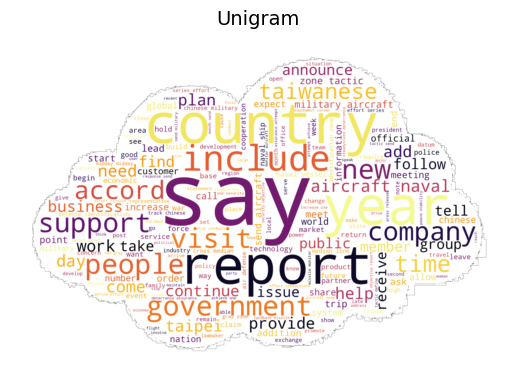

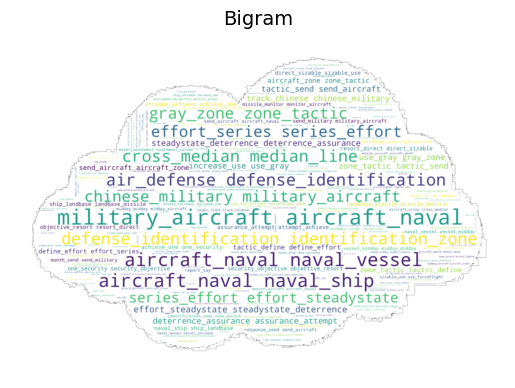

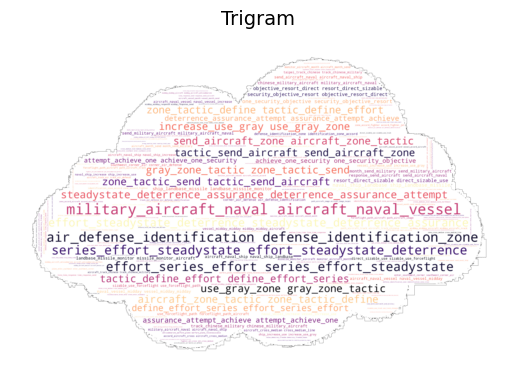

In [51]:
#display word-cloud based on n-gram
ngram = custom_ngram()
unigram = ngram.ngram_form_text(cleaning_df[column_name], 1)
bigram = ngram.ngram_form_text(cleaning_df[column_name], 2)
trigram = ngram.ngram_form_text(cleaning_df[column_name], 3)
wc = display_plot()
wc.plot_wordcloud_for_cluster("Unigram", unigram, mask_image)
wc.plot_wordcloud_for_cluster("Bigram", bigram, mask_image)
wc.plot_wordcloud_for_cluster("Trigram", trigram, mask_image)

### TF-IDF vectorizer

In [52]:
# process tfidf vectorizer for dataframe in specific column
tfidf = vectorizer(cleaning_df.copy(), column_name)

In [53]:
# check tfidf.document_term_matrix shape
tfidf.get_term_matrix().shape

(827, 102)

### K-means clustering

In [54]:
# process kmeans clustering
kmeans = kmeans_clustering()
kmeans_model_result, kmeans_model, number_of_cluster = kmeans.k_means(3, tfidf.get_term_matrix())

In [55]:
# call assign_cluster
result_df = kmeans.assign_cluster(cleaning_df.copy())

In [56]:
result_df.value_counts("cluster")

cluster
2    442
0    338
1     47
dtype: int64

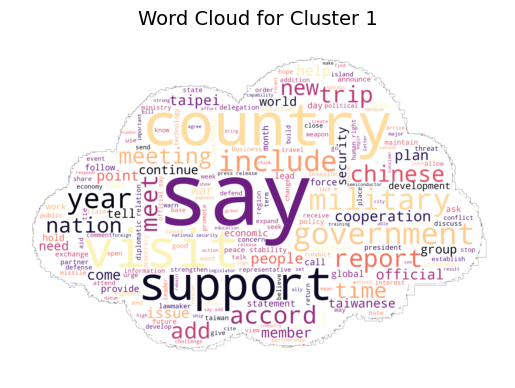

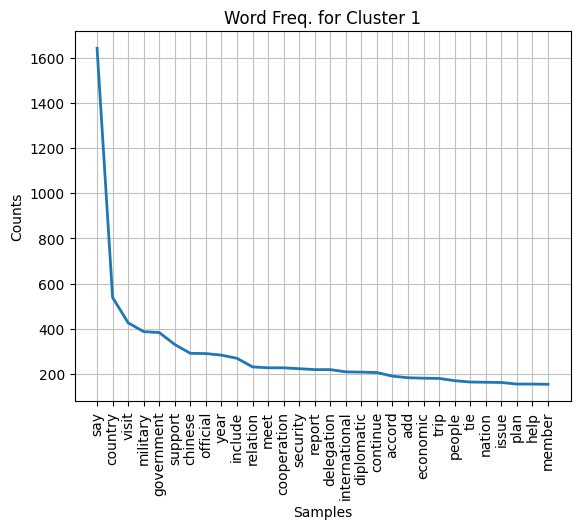

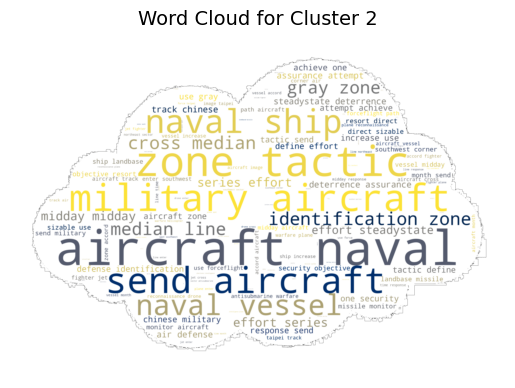

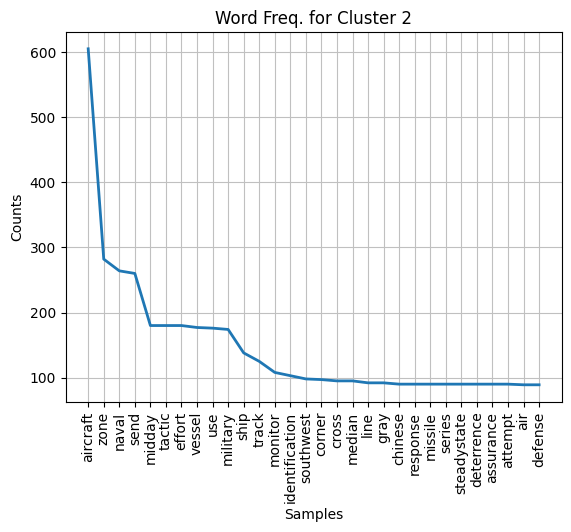

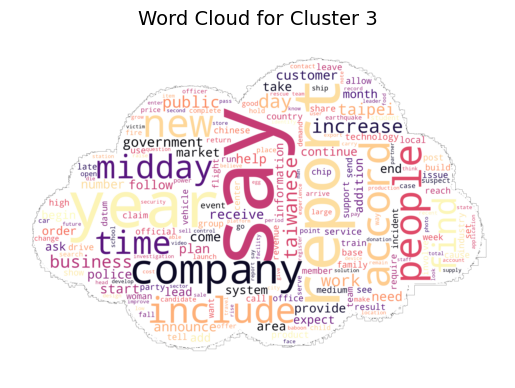

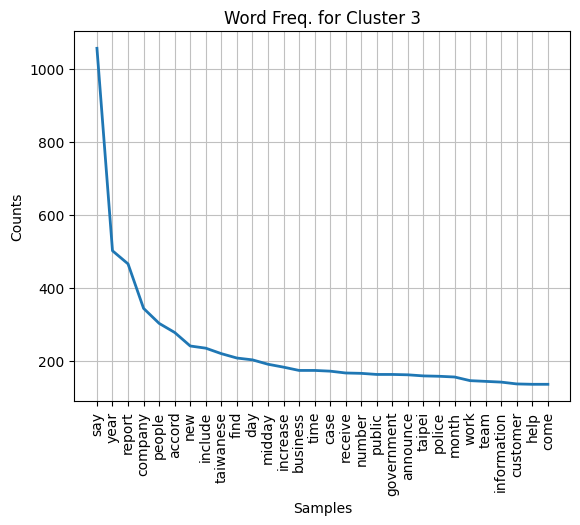

In [57]:
# display word cloud and frequency distribution for all topic
for cluster_index in range(number_of_cluster):
  this_wordlist = ''
  title = f"Word Cloud for Cluster {cluster_index+1}"
  titleFreq = f"Word Freq. for Cluster {cluster_index+1}"

  this_wordlist = result_df[result_df['cluster'] == cluster_index][column_name]
  this_seg_list=' '.join(this_wordlist) # convert list into string seperated with space character
  wc = display_plot()
  wc.plot_wordcloud_for_cluster(title, this_seg_list, mask_image)
  wc.plot_word_freq(30, titleFreq, this_seg_list)

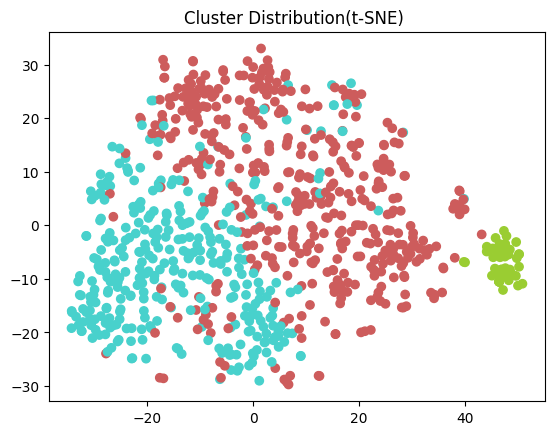

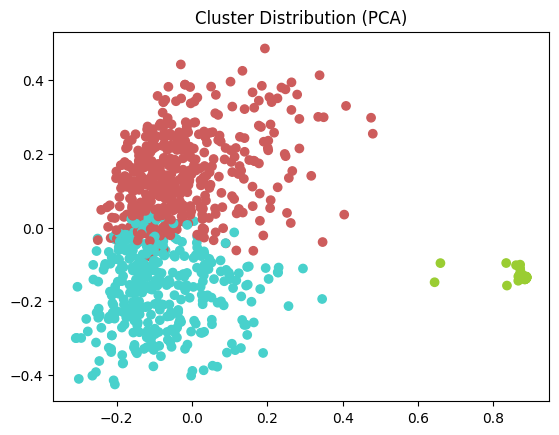

In [58]:
# displaying simple tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne_simple(result_df.copy(), tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca_simple(result_df.copy(), tfidf.get_term_matrix())

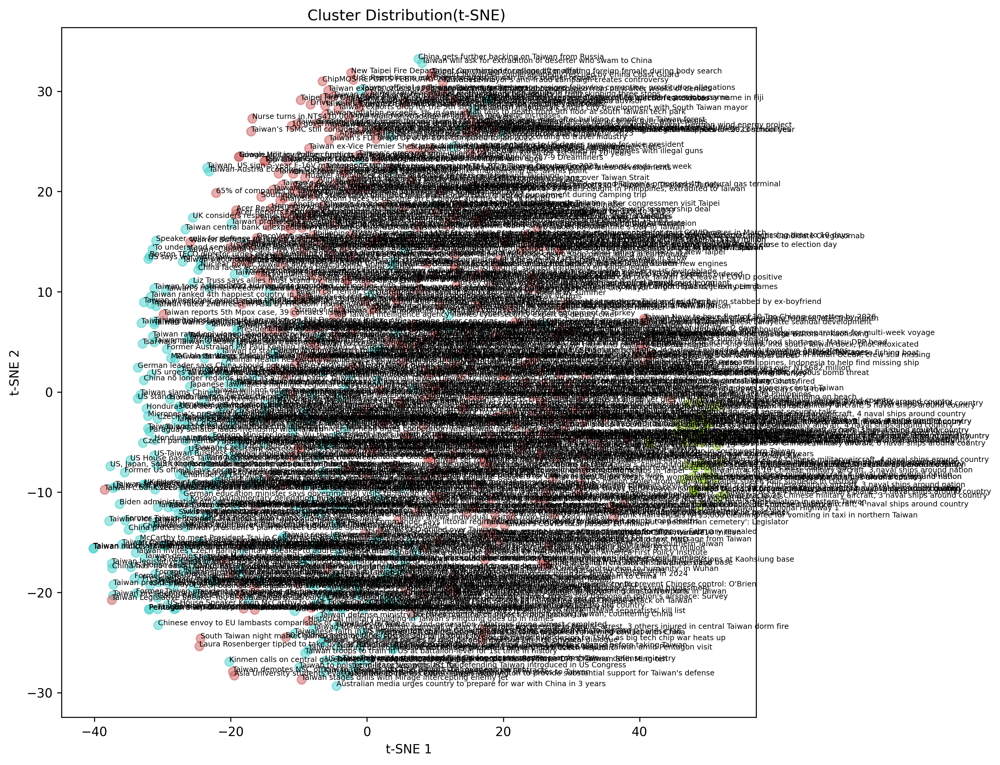

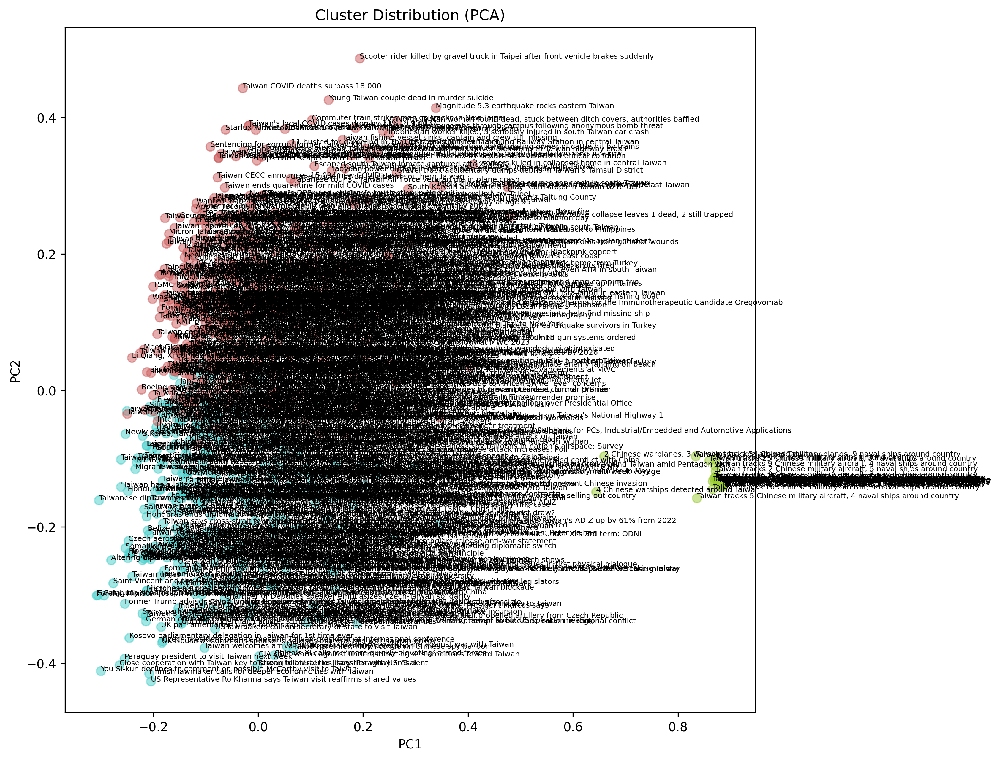

In [59]:
# displaying tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())

### K-medoid clustering

In [60]:
# process kmedoid clustering
kmedoid = kmedoid_clustering()
kmedoid_model_result, kmedoid_model, number_of_cluster = kmedoid.k_medoids(3, tfidf.get_term_matrix())

In [61]:
# call assign_cluster
result_df = kmedoid.assign_cluster(cleaning_df.copy())

In [62]:
result_df.value_counts("cluster")

cluster
2    538
1    163
0    126
dtype: int64

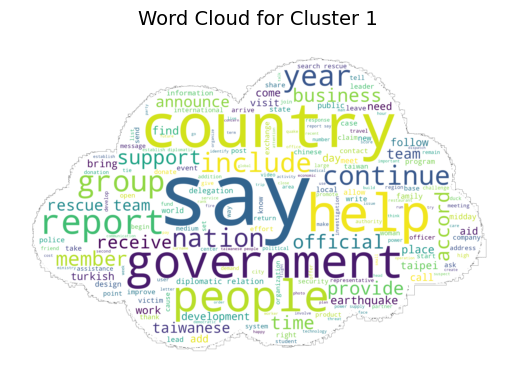

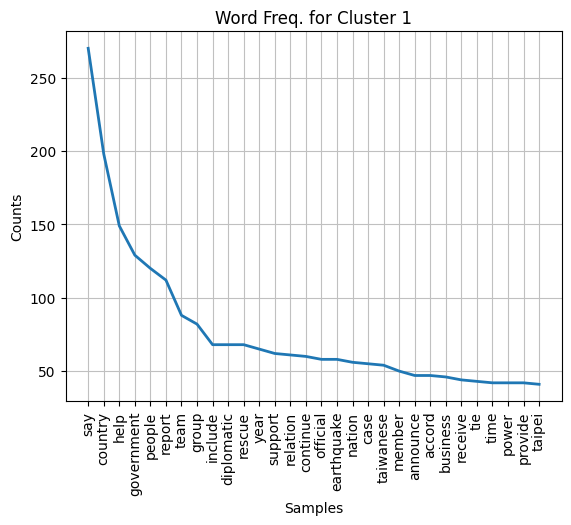

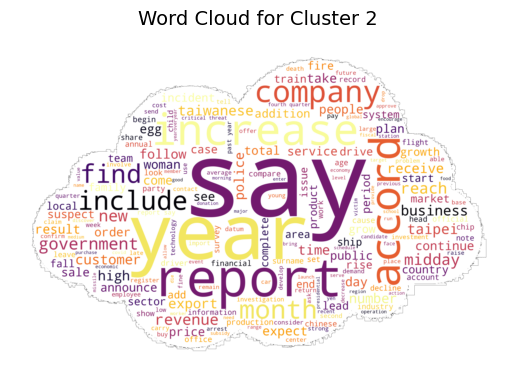

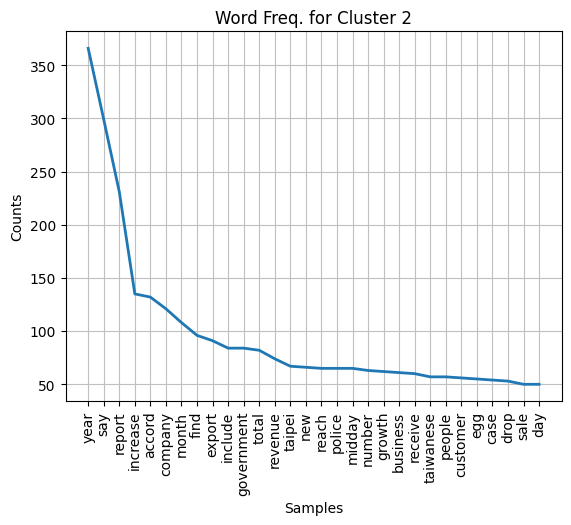

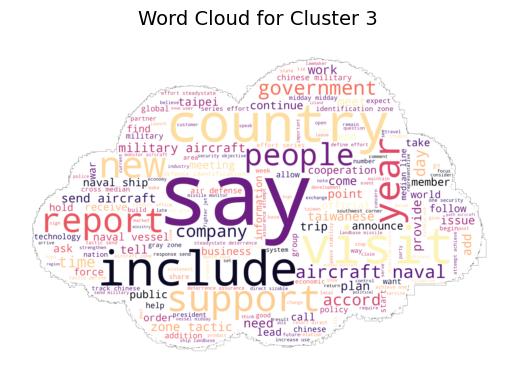

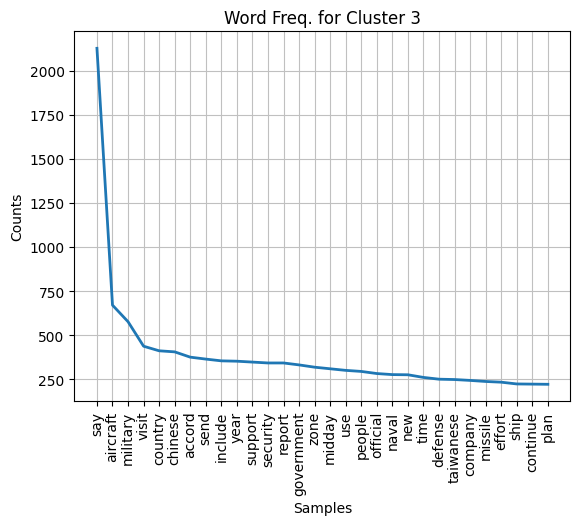

In [63]:
# display word cloud and frequency distribution for all topic
for cluster_index in range(number_of_cluster):
  this_wordlist = ''
  title = f"Word Cloud for Cluster {cluster_index+1}"
  titleFreq = f"Word Freq. for Cluster {cluster_index+1}"

  this_wordlist = result_df[result_df['cluster'] == cluster_index][column_name]
  this_seg_list=' '.join(this_wordlist) # convert list into string seperated with space character
  wc = display_plot()
  wc.plot_wordcloud_for_cluster(title, this_seg_list, mask_image)
  wc.plot_word_freq(30, titleFreq, this_seg_list)

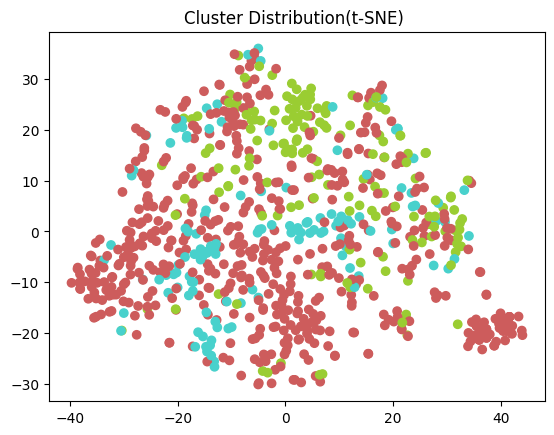

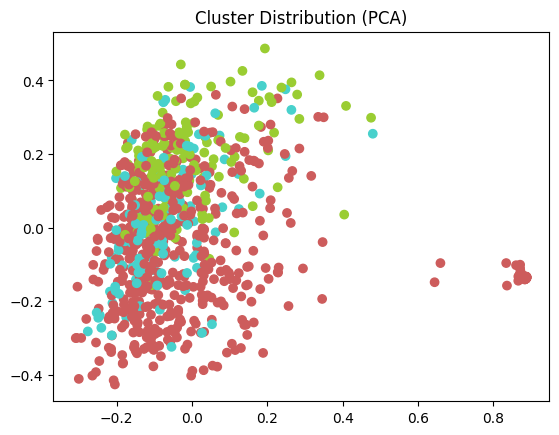

In [64]:
# displaying simple tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne_simple(result_df.copy(), tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca_simple(result_df.copy(), tfidf.get_term_matrix())

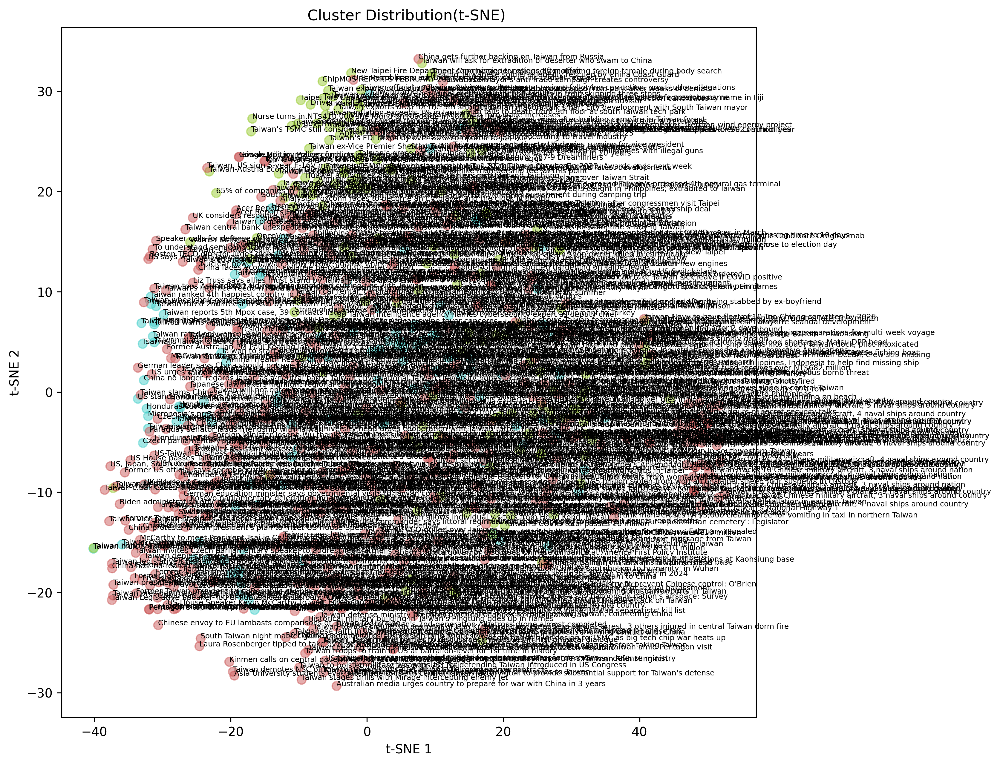

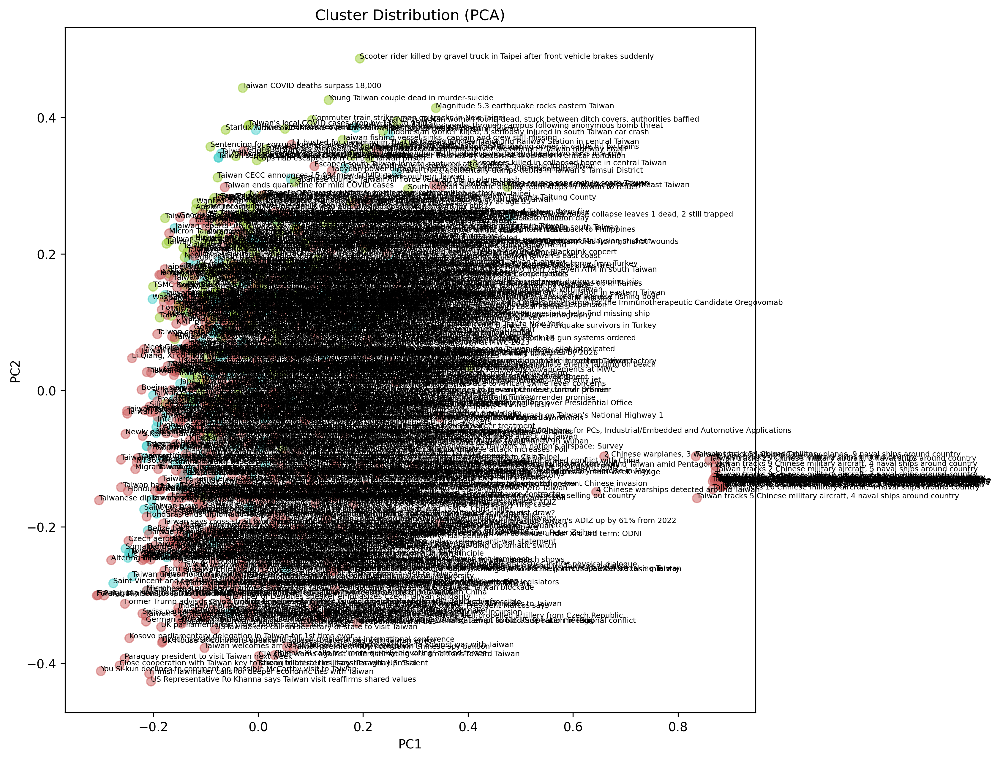

In [65]:
# displaying tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())

### LDA clustering

In [66]:
# process LDA clustering
lda = lda_clustering()
lda_model_result, lda_model, number_of_cluster = lda.fit_transform(3, tfidf.get_term_matrix())

In [67]:
# call assign_cluster
result_df = lda.assign_cluster(cleaning_df.copy())

In [68]:
result_df.value_counts("cluster")

cluster
2    542
1    213
0     72
dtype: int64

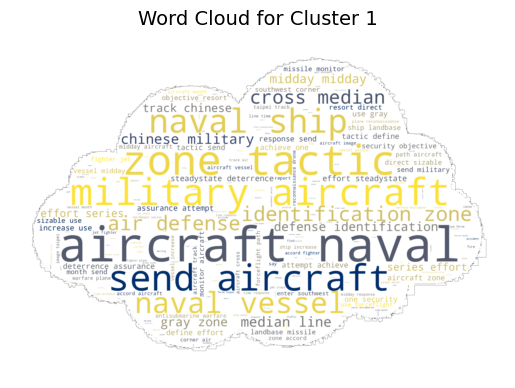

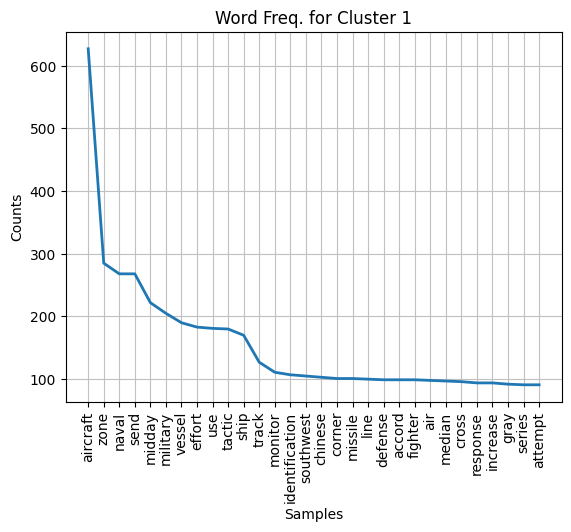

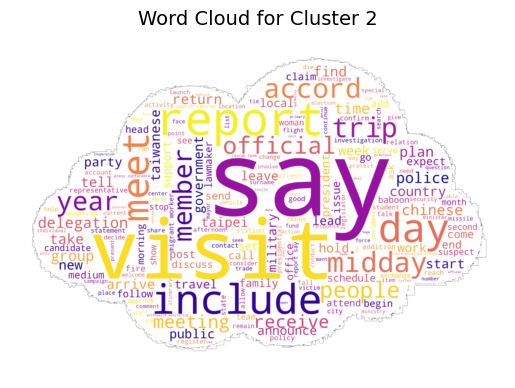

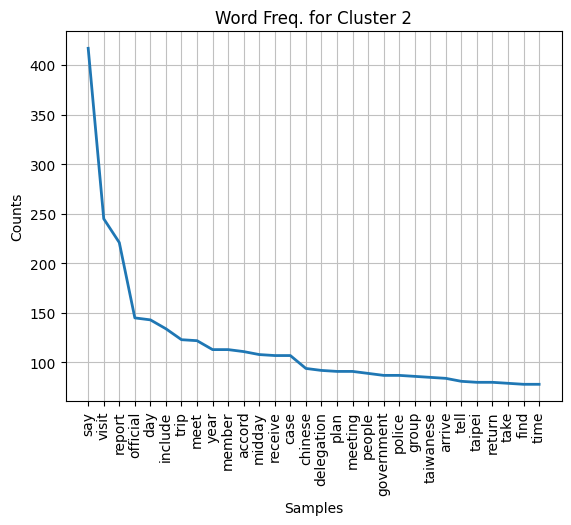

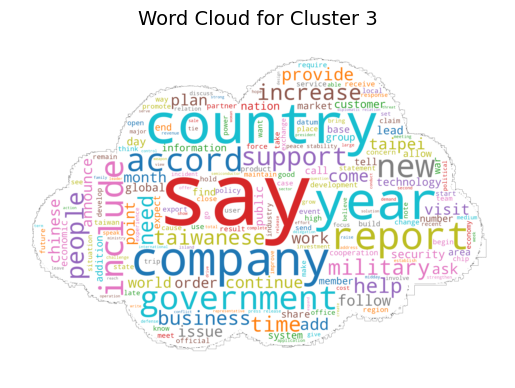

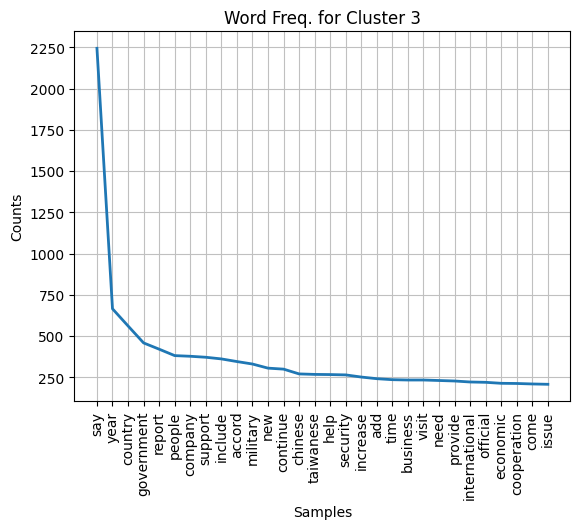

In [69]:
# display word cloud and frequency distribution for all topic
for cluster_index in range(number_of_cluster):
  this_wordlist = ''
  title = f"Word Cloud for Cluster {cluster_index+1}"
  titleFreq = f"Word Freq. for Cluster {cluster_index+1}"

  # comp=lda_model.components_[cluster_index]
  # vocab_comp = zip(tfidf.get_vocab(), comp)
  # sorted_words = dict(sorted(vocab_comp, key= lambda x:x[1], reverse=True))

  this_wordlist = result_df[result_df['cluster'] == cluster_index][column_name]
  this_seg_list=' '.join(this_wordlist) # convert list into string seperated with space character
  wc = display_plot()
  wc.plot_wordcloud_for_cluster(title, this_seg_list, mask_image)
  wc.plot_word_freq(30, titleFreq, this_seg_list)

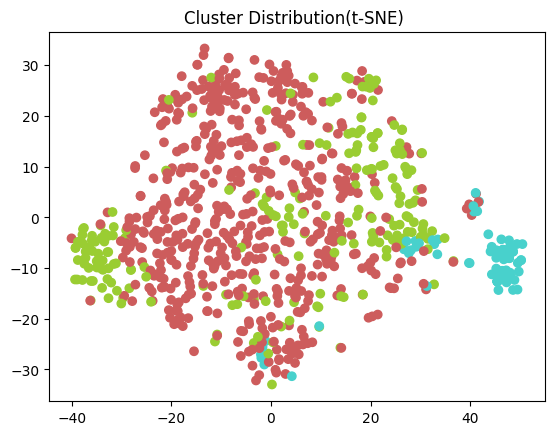

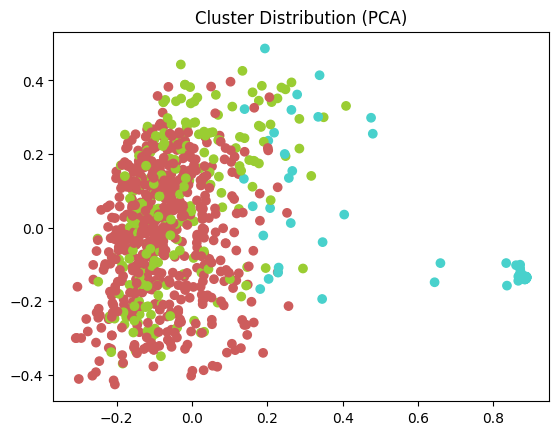

In [70]:
# displaying simple tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne_simple(result_df.copy(), tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca_simple(result_df.copy(), tfidf.get_term_matrix())

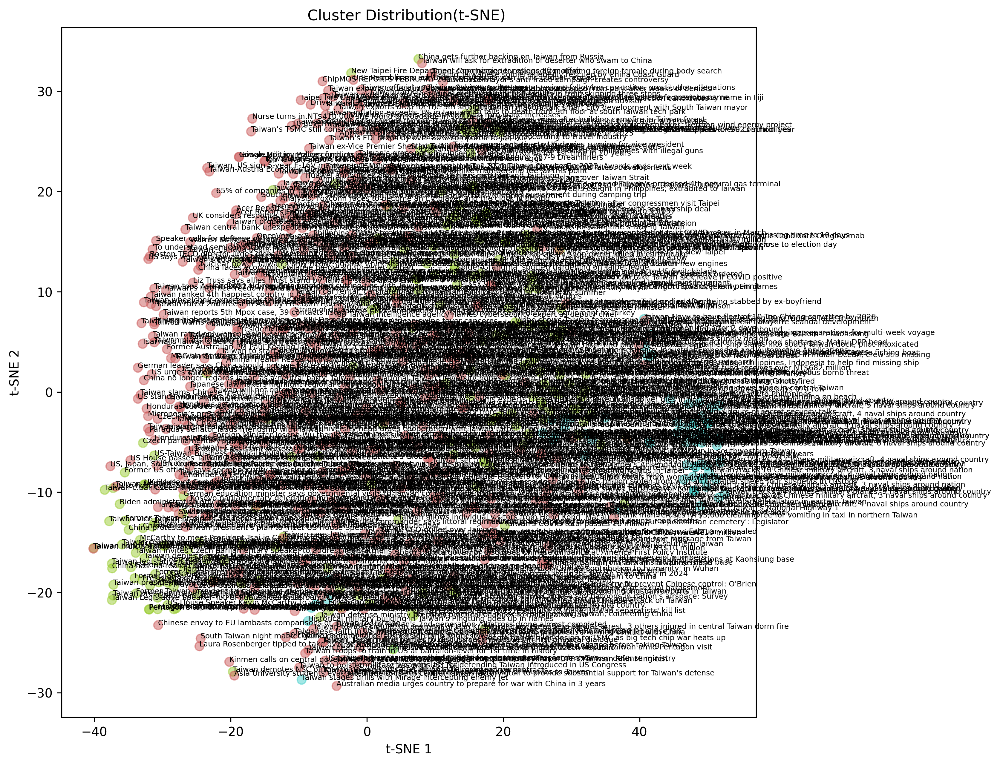

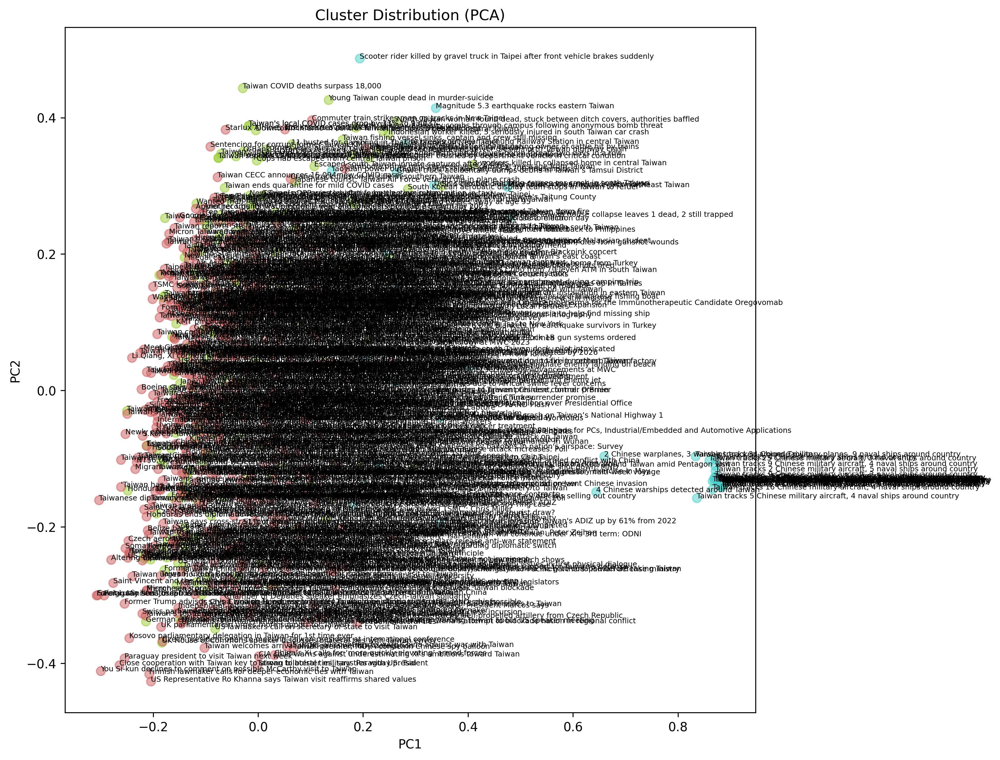

In [71]:
# displaying tsne and pca
tsne_plot = display_plot()
tsne_plot.tsne(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())

pca_plot = display_plot()
pca_plot.pca(result_df.copy(), number_of_cluster, tfidf.get_term_matrix())